In [1]:
from google.colab import drive
drive.mount('/drive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /drive


In [2]:
cd "/drive/Shared drives/repo/TensorFlow-2.x-Tutorials/16-fasterRCNN/"


/drive/Shared drives/repo/TensorFlow-2.x-Tutorials/16-fasterRCNN


In [13]:
import os
import tensorflow as tf
import numpy as np
import visualize
import matplotlib
%matplotlib inline
#matplotlib.use('TkAgg')

# eager execution
# tf.enable_eager_execution()
tf.executing_eagerly()

# tensorflow config - using one gpu and extending the GPU 
# memory region needed by the TensorFlow process
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
#config = tf.ConfigProto() # tf1.x style
#config.gpu_options.allow_growth = True
#session = tf.Session(config=config)

# increase memory, for ResNet101
gpus = tf.config.experimental.list_physical_devices('GPU')
if len(gpus) > 0:
    try: tf.config.experimental.set_memory_growth(gpus[0], True)
    except RuntimeError: pass


#### CocoDataSet

In [4]:
from detection.datasets import coco, data_generator

In [5]:
 
import os.path as osp
import cv2
import numpy as np
from pycocotools.coco import COCO

from detection.datasets import transforms, utils

class CocoDataSet(object):
    def __init__(self, dataset_dir, subset,
                 flip_ratio=0,
                 pad_mode='fixed',
                 mean=(0, 0, 0),
                 std=(1, 1, 1),
                 scale=(1024, 800),
                 debug=False):
        '''Load a subset of the COCO dataset.
        
        Attributes
        ---
            dataset_dir: The root directory of the COCO dataset.
            subset: What to load (train, val).
            flip_ratio: Float. The ratio of flipping an image and its bounding boxes.
            pad_mode: Which padded method to use (fixed, non-fixed)
            mean: Tuple. Image mean.
            std: Tuple. Image standard deviation.
            scale: Tuple of two integers.
        '''
        
        if subset not in ['train', 'val', 'test']:
            raise AssertionError('subset must be "train" or "val".')
            

        self.coco = COCO("{}/annotations/instances_{}2017.json".format(dataset_dir, subset))

        # get the mapping from original category ids to labels
        self.cat_ids = self.coco.getCatIds()
        self.cat2label = {
            cat_id: i + 1
            for i, cat_id in enumerate(self.cat_ids)
        }
        self.label2cat = {
            i + 1: cat_id
            for i, cat_id in enumerate(self.cat_ids)
        }
        
        self.img_ids, self.img_infos = self._filter_imgs()
        
        if debug:
            self.img_ids, self.img_infos = self.img_ids[:20], self.img_infos[:20]
            
        self.image_dir = "{}/{}2017".format(dataset_dir, subset)
        
        self.flip_ratio = flip_ratio
        
        if pad_mode in ['fixed', 'non-fixed']:
            self.pad_mode = pad_mode
        elif subset == 'train':
            self.pad_mode = 'fixed'
        else:
            self.pad_mode = 'non-fixed'
        
        self.img_transform = transforms.ImageTransform(scale, mean, std, pad_mode)
        self.bbox_transform = transforms.BboxTransform()
        
        
    def _filter_imgs(self, min_size=32):
        '''Filter images too small or without ground truths.
        
        Args
        ---
            min_size: the minimal size of the image.
        '''
        # Filter images without ground truths.
        all_img_ids = list(set([_['image_id'] for _ in self.coco.anns.values()]))
        # Filter images too small.
        img_ids = []
        img_infos = []
        for i in all_img_ids:
            info = self.coco.loadImgs(i)[0]
            
            ann_ids = self.coco.getAnnIds(imgIds=i)
            ann_info = self.coco.loadAnns(ann_ids)
            ann = self._parse_ann_info(ann_info)
            
            if min(info['width'], info['height']) >= min_size and ann['labels'].shape[0] != 0:
                img_ids.append(i)
                img_infos.append(info)
        return img_ids, img_infos
        
    def _load_ann_info(self, idx):
        img_id = self.img_ids[idx]
        ann_ids = self.coco.getAnnIds(imgIds=img_id)
        ann_info = self.coco.loadAnns(ann_ids)
        return ann_info

    def _parse_ann_info(self, ann_info):
        '''Parse bbox annotation.
        
        Args
        ---
            ann_info (list[dict]): Annotation info of an image.
            
        Returns
        ---
            dict: A dict containing the following keys: bboxes, 
                bboxes_ignore, labels.
        '''
        gt_bboxes = []
        gt_labels = []
        gt_bboxes_ignore = []

        for i, ann in enumerate(ann_info):
            if ann.get('ignore', False):
                continue
            x1, y1, w, h = ann['bbox']
            if ann['area'] <= 0 or w < 1 or h < 1:
                continue
            bbox = [y1, x1, y1 + h - 1, x1 + w - 1]
            if ann['iscrowd']:
                gt_bboxes_ignore.append(bbox)
            else:
                gt_bboxes.append(bbox)
                gt_labels.append(self.cat2label[ann['category_id']])

        if gt_bboxes:
            gt_bboxes = np.array(gt_bboxes, dtype=np.float32)
            gt_labels = np.array(gt_labels, dtype=np.int64)
        else:
            gt_bboxes = np.zeros((0, 4), dtype=np.float32)
            gt_labels = np.array([], dtype=np.int64)

        if gt_bboxes_ignore:
            gt_bboxes_ignore = np.array(gt_bboxes_ignore, dtype=np.float32)
        else:
            gt_bboxes_ignore = np.zeros((0, 4), dtype=np.float32)

        ann = dict(
            bboxes=gt_bboxes, labels=gt_labels, bboxes_ignore=gt_bboxes_ignore)


        return ann
    
    def __len__(self):
        return len(self.img_infos)
    
    def __getitem__(self, idx):
        '''Load the image and its bboxes for the given index.
        
        Args
        ---
            idx: the index of images.
            
        Returns
        ---
            tuple: A tuple containing the following items: image, 
                bboxes, labels.
        '''
        img_info = self.img_infos[idx]
        ann_info = self._load_ann_info(idx)
        
        # load the image.
        print(img_info['file_name'])
        img = cv2.imread(osp.join(self.image_dir, img_info['file_name']), cv2.IMREAD_COLOR)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        ori_shape = img.shape
        
        # Load the annotation.
        ann = self._parse_ann_info(ann_info)
        bboxes = ann['bboxes']
        labels = ann['labels']
        
        flip = True if np.random.rand() < self.flip_ratio else False
        
        # Handle the image
        img, img_shape, scale_factor = self.img_transform(img, flip)

        pad_shape = img.shape
        
        # Handle the annotation.
        bboxes, labels = self.bbox_transform(
            bboxes, labels, img_shape, scale_factor, flip)
        
        # Handle the meta info.
        img_meta_dict = dict({
            'ori_shape': ori_shape,
            'img_shape': img_shape,
            'pad_shape': pad_shape,
            'scale_factor': scale_factor,
            'flip': flip
        })

        img_meta = utils.compose_image_meta(img_meta_dict)
        
        return img, img_meta, bboxes, labels
    
    def get_categories(self):
        '''Get list of category names. 
        
        Returns
        ---
            list: A list of category names.
            
        Note that the first item 'bg' means background.
        '''
        return ['bg'] + [self.coco.loadCats(i)[0]["name"] for i in self.cat2label.keys()]


#### load dataset

In [6]:
img_mean = (123.675, 116.28, 103.53)
# img_std = (58.395, 57.12, 57.375)
img_std = (1., 1., 1.)

In [7]:
train_dataset = CocoDataSet('./LEs', 'train',
                                 flip_ratio=0.0,
                                 pad_mode='fixed',
                                 mean=img_mean,
                                 std=img_std,
                                 scale=(800, 1024))

test_dataset = CocoDataSet('./LEs/', 'test',
                                 flip_ratio=0.0,
                                 pad_mode='fixed',
                                 mean=img_mean,
                                 std=img_std,
                                 scale=(800, 1024))


loading annotations into memory...
Done (t=0.76s)
creating index...
index created!
loading annotations into memory...
Done (t=0.22s)
creating index...
index created!


In [ ]:
train_dataset.get_categories()

['bg', '_background_', 'LE', 'star']

In [ ]:
len(train_dataset), len(test_dataset)

(12, 11)

#### display a sample

In [8]:
def view_label(inputs):
    img, img_meta, bboxes, labels = inputs
    rgb_img = np.round(img + img_mean)

    visualize.display_instances(rgb_img, bboxes, labels, train_dataset.get_categories())


40.jpg


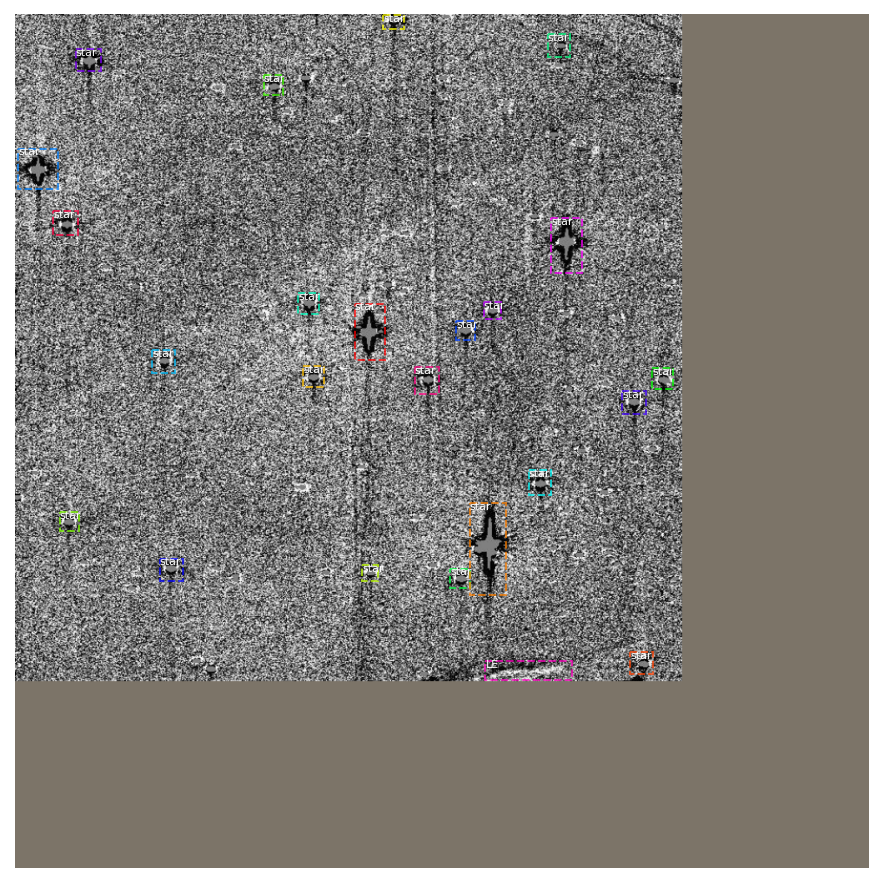

In [10]:
view_label(train_dataset[1])

In [11]:
#img, img_meta, bboxes, labels = train_dataset[1]
img, img_meta, bboxes, labels = test_dataset[1]
rgb_img = np.round(img + img_mean)



102.jpg


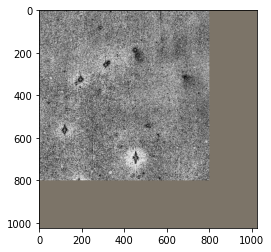

In [ ]:
from matplotlib import pyplot as plt
plt.imshow(rgb_img.astype(np.int32))


#### load model

In [49]:
#import tensorflow as tf

from detection.models.backbones import resnet
from detection.models.necks import fpn
from detection.models.rpn_heads import rpn_head
from detection.models.bbox_heads import bbox_head
from detection.models.roi_extractors import roi_align
from detection.models.detectors.test_mixins import RPNTestMixin, BBoxTestMixin

from detection.core.bbox import bbox_target

class FasterRCNN(tf.keras.Model, RPNTestMixin, BBoxTestMixin):

    def __init__(self, num_classes, **kwags):
        super(FasterRCNN, self).__init__(**kwags)
       
        self.NUM_CLASSES = num_classes
        
        # RPN configuration
        # Anchor attributes
        self.ANCHOR_SCALES = (32, 64, 128, 256, 512)
        self.ANCHOR_RATIOS = (0.5, 1, 2)
        self.ANCHOR_FEATURE_STRIDES = (4, 8, 16, 32, 64)
        
        # Bounding box refinement mean and standard deviation
        self.RPN_TARGET_MEANS = (0., 0., 0., 0.)
        self.RPN_TARGET_STDS = (0.1, 0.1, 0.2, 0.2)
        
        # RPN training configuration
        self.PRN_BATCH_SIZE = 256
        self.RPN_POS_FRAC = 0.5
        self.RPN_POS_IOU_THR = 0.5
        self.RPN_NEG_IOU_THR = 0.5

        # ROIs kept configuration
        self.PRN_PROPOSAL_COUNT = 2000
        self.PRN_NMS_THRESHOLD = 0.7
        
        # RCNN configuration
        # Bounding box refinement mean and standard deviation
        self.RCNN_TARGET_MEANS = (0., 0., 0., 0.)
        self.RCNN_TARGET_STDS = (0.1, 0.1, 0.2, 0.2)
        
        # ROI Feat Size
        self.POOL_SIZE = (7, 7)
        
        # RCNN training configuration
        self.RCNN_BATCH_SIZE = 256
        self.RCNN_POS_FRAC = 0.25
        self.RCNN_POS_IOU_THR = 0.7
        self.RCNN_NEG_IOU_THR = 0.3
        
        # Boxes kept configuration
        self.RCNN_MIN_CONFIDENCE = 0.3
        self.RCNN_NME_THRESHOLD = 0.3
        self.RCNN_MAX_INSTANCES = 100
        
        # Target Generator for the second stage.
        self.bbox_target = bbox_target.ProposalTarget(
            target_means=self.RCNN_TARGET_MEANS,
            target_stds=self.RPN_TARGET_STDS, 
            num_rcnn_deltas=self.RCNN_BATCH_SIZE,
            positive_fraction=self.RCNN_POS_FRAC,
            pos_iou_thr=self.RCNN_POS_IOU_THR,
            neg_iou_thr=self.RCNN_NEG_IOU_THR)
                
        # Modules
        self.backbone = resnet.ResNet(
            depth=101, 
            name='res_net')
        
        self.neck = fpn.FPN(
            name='fpn')
        
        self.rpn_head = rpn_head.RPNHead(
            anchor_scales=self.ANCHOR_SCALES,
            anchor_ratios=self.ANCHOR_RATIOS,
            anchor_feature_strides=self.ANCHOR_FEATURE_STRIDES,
            proposal_count=self.PRN_PROPOSAL_COUNT,
            nms_threshold=self.PRN_NMS_THRESHOLD,
            target_means=self.RPN_TARGET_MEANS,
            target_stds=self.RPN_TARGET_STDS,
            num_rpn_deltas=self.PRN_BATCH_SIZE,
            positive_fraction=self.RPN_POS_FRAC,
            pos_iou_thr=self.RPN_POS_IOU_THR,
            neg_iou_thr=self.RPN_NEG_IOU_THR,
            name='rpn_head')
        
        self.roi_align = roi_align.PyramidROIAlign(
            pool_shape=self.POOL_SIZE,
            name='pyramid_roi_align')
        
        self.bbox_head = bbox_head.BBoxHead(
            num_classes=self.NUM_CLASSES,
            pool_size=self.POOL_SIZE,
            target_means=self.RCNN_TARGET_MEANS,
            target_stds=self.RCNN_TARGET_STDS,
            min_confidence=self.RCNN_MIN_CONFIDENCE,
            nms_threshold=self.RCNN_NME_THRESHOLD,
            max_instances=self.RCNN_MAX_INSTANCES,
            name='b_box_head')

    def call(self, inputs, training=True):
        """

        :param inputs: [1, 1216, 1216, 3], [1, 11], [1, 14, 4], [1, 14]
        :param training:
        :return:
        """
        if training: # training
            imgs, img_metas, gt_boxes, gt_class_ids = inputs
        else: # inference
            imgs, img_metas = inputs
        # [1, 304, 304, 256] => [1, 152, 152, 512]=>[1,76,76,1024]=>[1,38,38,2048]
        C2, C3, C4, C5 = self.backbone(imgs, 
                                       training=training)
        # [1, 304, 304, 256] <= [1, 152, 152, 256]<=[1,76,76,256]<=[1,38,38,256]=>[1,19,19,256]
        P2, P3, P4, P5, P6 = self.neck([C2, C3, C4, C5], 
                                       training=training)
        
        rpn_feature_maps = [P2, P3, P4, P5, P6]
        rcnn_feature_maps = [P2, P3, P4, P5]
        # [1, 369303, 2] [1, 369303, 2], [1, 369303, 4], includes all anchors on pyramid level of features
        rpn_class_logits, rpn_probs, rpn_deltas = self.rpn_head(
            rpn_feature_maps, training=training)
        # [369303, 4] => [215169, 4], valid => [6000, 4], performance =>[2000, 4],  NMS
        proposals_list = self.rpn_head.get_proposals(
            rpn_probs, rpn_deltas, img_metas)
        
        if training: # get target value for these proposal target label and target delta
            rois_list, rcnn_target_matchs_list, rcnn_target_deltas_list = \
                self.bbox_target.build_targets(
                    proposals_list, gt_boxes, gt_class_ids, img_metas)
        else:
            rois_list = proposals_list
        # rois_list only contains coordinates, rcnn_feature_maps save the 5 features data=>[192,7,7,256]
        pooled_regions_list = self.roi_align(#
            (rois_list, rcnn_feature_maps, img_metas), training=training)
        # [192, 81], [192, 81], [192, 81, 4]
        rcnn_class_logits_list, rcnn_probs_list, rcnn_deltas_list = \
            self.bbox_head(pooled_regions_list, training=training)

        if training:         
            rpn_class_loss, rpn_bbox_loss = self.rpn_head.loss(
                rpn_class_logits, rpn_deltas, gt_boxes, gt_class_ids, img_metas)
            
            rcnn_class_loss, rcnn_bbox_loss = self.bbox_head.loss(
                rcnn_class_logits_list, rcnn_deltas_list, 
                rcnn_target_matchs_list, rcnn_target_deltas_list)
            
            return [rpn_class_loss, rpn_bbox_loss, 
                    rcnn_class_loss, rcnn_bbox_loss]
        else:
            detections_list = self.bbox_head.get_bboxes(
                rcnn_probs_list, rcnn_deltas_list, rois_list, img_metas)
        
            return detections_list


In [50]:
# from detection.models.detectors import faster_rcnn
#model = faster_rcnn.FasterRCNN(
#    num_classes=len(train_dataset.get_categories()))
model = FasterRCNN(
    num_classes=len(train_dataset.get_categories()))

In [51]:
model.RCNN_MIN_CONFIDENCE

0.3

In [52]:
batch_imgs = tf.Variable(np.expand_dims(img, 0))
batch_metas = tf.Variable(np.expand_dims(img_meta, 0))
batch_bboxes = tf.Variable(np.expand_dims(bboxes, 0))
batch_labels = tf.Variable(np.expand_dims(labels, 0))


In [53]:
_ = model((batch_imgs, batch_metas, batch_bboxes, batch_labels), training=True)

In [54]:
#model.load_weights('weights/faster_rcnn.h5')
model.load_weights('weights/fasterrcnn_LE.h5')


In [ ]:
model.summary()

Model: "faster_rcnn"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
res_net (ResNet)             multiple                  42658176  
_________________________________________________________________
fpn (FPN)                    multiple                  3344384   
_________________________________________________________________
rpn_head (RPNHead)           multiple                  1189394   
_________________________________________________________________
pyramid_roi_align (PyramidRO multiple                  0         
_________________________________________________________________
b_box_head (BBoxHead)        multiple                  13924372  
Total params: 61,116,326
Trainable params: 61,006,886
Non-trainable params: 109,440
_________________________________________________________________


### Stage 1: Region Proposal Network

#### 1.a RPN Targets

In [ ]:
anchors, valid_flags = model.rpn_head.generator.generate_pyramid_anchors(batch_metas)

rpn_target_matchs, rpn_target_deltas = model.rpn_head.anchor_target.build_targets(
                anchors, valid_flags, batch_bboxes, batch_labels)

In [ ]:
rpn_target_matchs.shape, rpn_target_deltas.shape

(TensorShape([1, 261888]), TensorShape([1, 256, 4]))

In [ ]:
positive_anchors = tf.gather(anchors, tf.where(tf.equal(rpn_target_matchs, 1))[:, 1])
negative_anchors = tf.gather(anchors, tf.where(tf.equal(rpn_target_matchs, -1))[:, 1])
neutral_anchors = tf.gather(anchors, tf.where(tf.equal(rpn_target_matchs, 0))[:, 1]) 
positive_target_deltas = rpn_target_deltas[0, :tf.where(tf.equal(rpn_target_matchs, 1)).shape[0]]

In [ ]:
from detection.core.bbox import transforms
    
refined_anchors = transforms.delta2bbox(
    positive_anchors, positive_target_deltas, (0., 0., 0., 0.), (0.1, 0.1, 0.2, 0.2))

In [ ]:
print('rpn_target_matchs:\t', rpn_target_matchs[0].shape.as_list())
print('rpn_target_deltas:\t', rpn_target_deltas[0].shape.as_list())
print('positive_anchors:\t', positive_anchors.shape.as_list())
print('negative_anchors:\t', negative_anchors.shape.as_list())
print('neutral_anchors:\t', neutral_anchors.shape.as_list())
print('refined_anchors:\t', refined_anchors.shape.as_list())

rpn_target_matchs:	 [261888]
rpn_target_deltas:	 [256, 4]
positive_anchors:	 [25, 4]
negative_anchors:	 [231, 4]
neutral_anchors:	 [261632, 4]
refined_anchors:	 [25, 4]


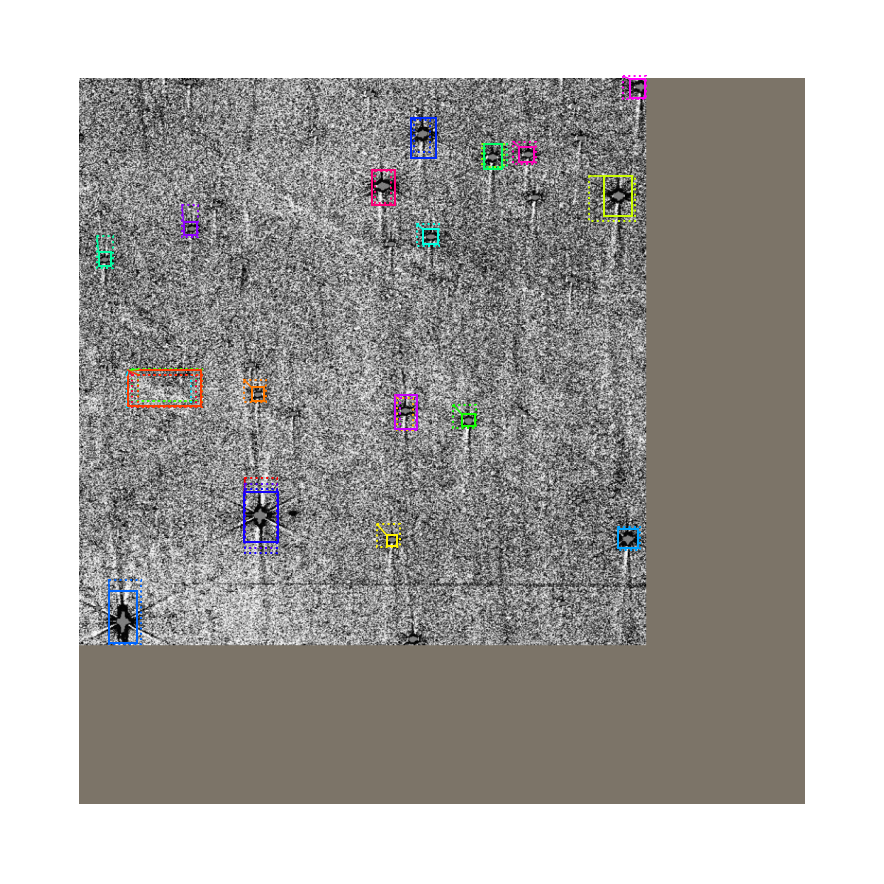

In [ ]:
visualize.draw_boxes(rgb_img, 
                     boxes=positive_anchors.numpy(), 
                     refined_boxes=refined_anchors.numpy())

#### 1.b RPN Predictions

In [ ]:
training = False

# ResNet 
C2, C3, C4, C5 = model.backbone(batch_imgs, 
                                training=training)

# FPN
P2, P3, P4, P5, P6 = model.neck([C2, C3, C4, C5], 
                                training=training)

rpn_feature_maps = [P2, P3, P4, P5, P6]
rcnn_feature_maps = [P2, P3, P4, P5]

rpn_class_logits, rpn_probs, rpn_deltas = model.rpn_head(
    rpn_feature_maps, training=training)

In [ ]:
C2.shape, C3.shape, C4.shape, C5.shape

(TensorShape([1, 256, 256, 256]),
 TensorShape([1, 128, 128, 512]),
 TensorShape([1, 64, 64, 1024]),
 TensorShape([1, 32, 32, 2048]))

In [ ]:
P2.shape, P3.shape, P4.shape, P5.shape, P6.shape

(TensorShape([1, 256, 256, 256]),
 TensorShape([1, 128, 128, 256]),
 TensorShape([1, 64, 64, 256]),
 TensorShape([1, 32, 32, 256]),
 TensorShape([1, 16, 16, 256]))

In [ ]:
rpn_class_logits.shape, rpn_probs.shape, rpn_deltas.shape

(TensorShape([1, 261888, 2]),
 TensorShape([1, 261888, 2]),
 TensorShape([1, 261888, 4]))

In [ ]:
rpn_probs_tmp = rpn_probs[0, :, 1]

In [ ]:
# Show top anchors by score (before refinement)
limit = 100
ix = tf.nn.top_k(rpn_probs_tmp, k=limit).indices[::-1]


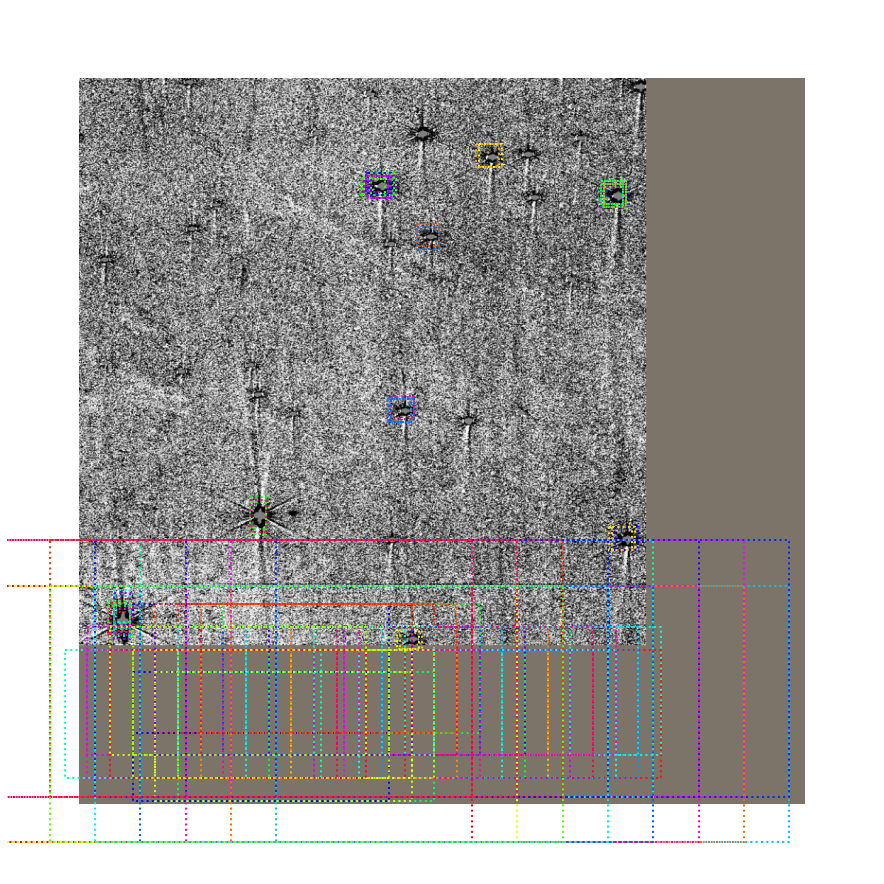

In [ ]:
visualize.draw_boxes(rgb_img, boxes=tf.gather(anchors, ix).numpy())


### Stage 2:  Proposal Classification

In [ ]:
proposals_list = model.rpn_head.get_proposals(
    rpn_probs, rpn_deltas, batch_metas)

In [ ]:
proposals_list[0].shape

TensorShape([2000, 4])

In [ ]:
rois_list = proposals_list

pooled_regions_list = model.roi_align(
    (rois_list, rcnn_feature_maps, batch_metas), training=training)

rcnn_class_logits_list, rcnn_probs_list, rcnn_deltas_list = \
    model.bbox_head(pooled_regions_list, training=training)


In [ ]:
pooled_regions_list[0].shape

TensorShape([2000, 7, 7, 256])

In [ ]:
detections_list = model.bbox_head.get_bboxes(
    rcnn_probs_list, rcnn_deltas_list, rois_list, batch_metas)

In [ ]:
tmp = detections_list[0][:, :4]

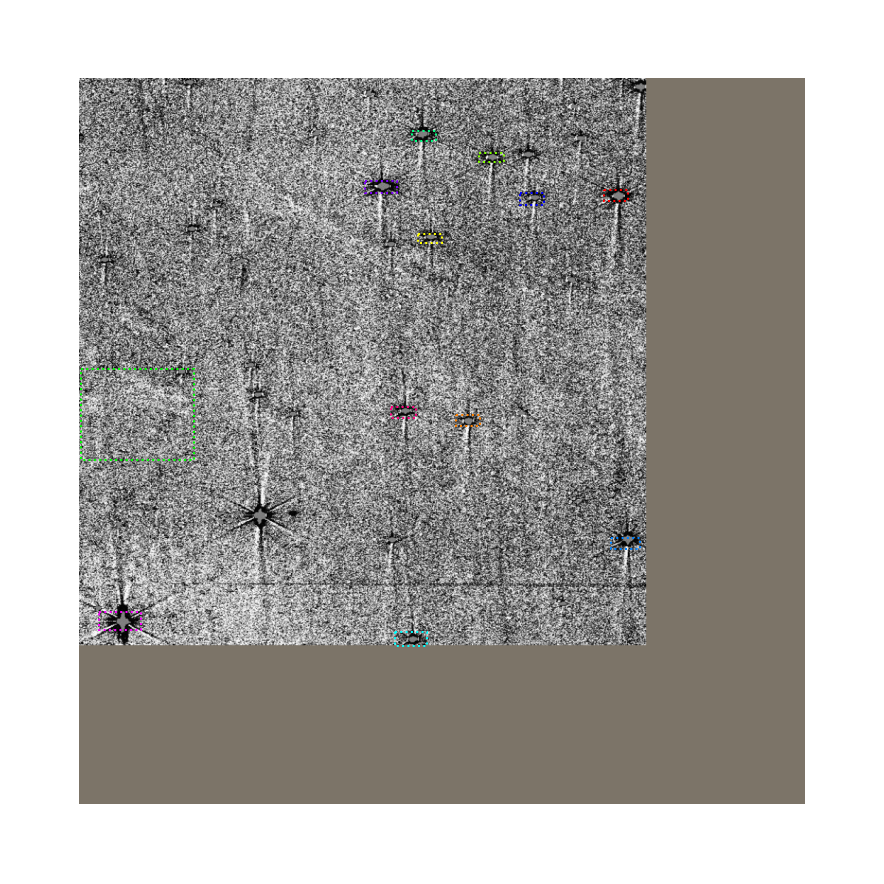

In [ ]:
visualize.draw_boxes(rgb_img, boxes=tmp.numpy())

### Stage 3: Run model directly

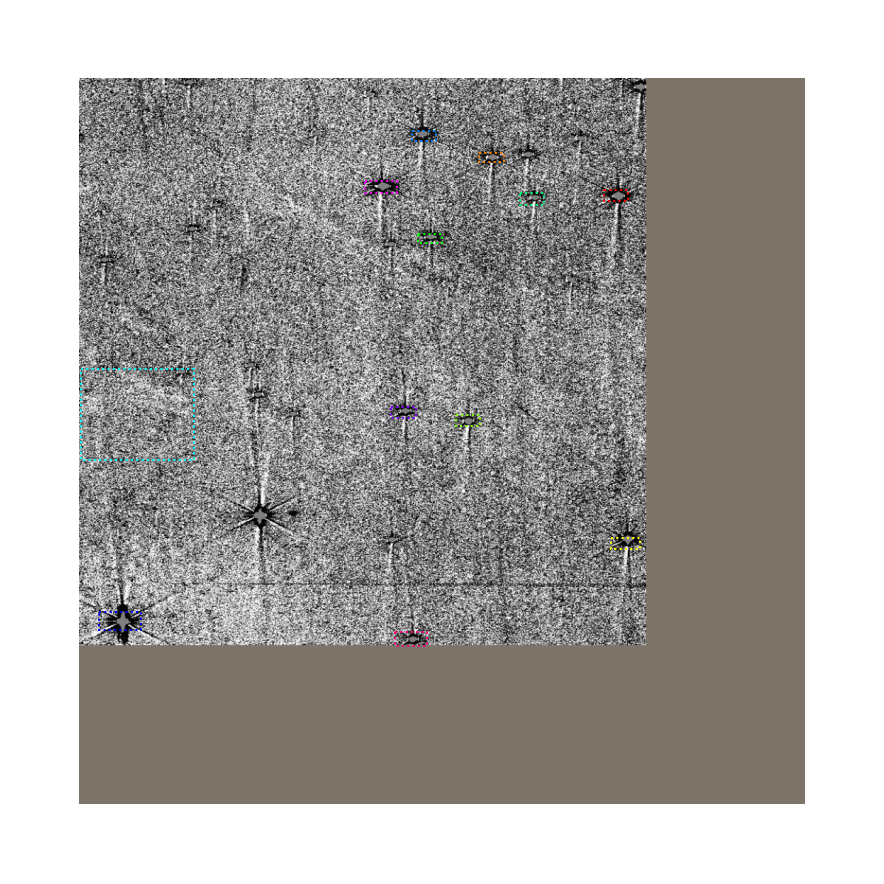

In [ ]:
detections_list = model((batch_imgs, batch_metas), training=False)
tmp = detections_list[0][:, :4]
visualize.draw_boxes(rgb_img, boxes=tmp.numpy())

### Stage 4: Test (Detection)

In [ ]:
test_dataset = CocoDataSet('./LEs/', 'test',
                                 flip_ratio=0.0,
                                 pad_mode='fixed',
                                 mean=img_mean,
                                 std=img_std,
                                 scale=(800, 1024))


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [ ]:
img.max()

151.47

In [18]:
from detection.datasets.utils import get_original_image

def detect_on(inputs):
    img, img_meta, bboxes, labels = inputs
    
    ori_img = get_original_image(img, img_meta, img_mean)
    proposals = model.simple_test_rpn(img, img_meta)
    res = model.simple_test_bboxes(img, img_meta, proposals)
    visualize.display_instances(ori_img, res['rois'], res['class_ids'], 
                            train_dataset.get_categories(), scores=res['scores'])
    

In [ ]:
img, img_meta, bboxes, labels = test_dataset[2]

In [19]:
from detection.datasets.utils import get_original_image
ori_img = get_original_image(img, img_meta, img_mean)

In [20]:
proposals = model.simple_test_rpn(img, img_meta)
res = model.simple_test_bboxes(img, img_meta, proposals)

In [ ]:
visualize.display_instances(ori_img, res['rois'], res['class_ids'], 
                            train_dataset.get_categories(), scores=res['scores'])

46.jpg


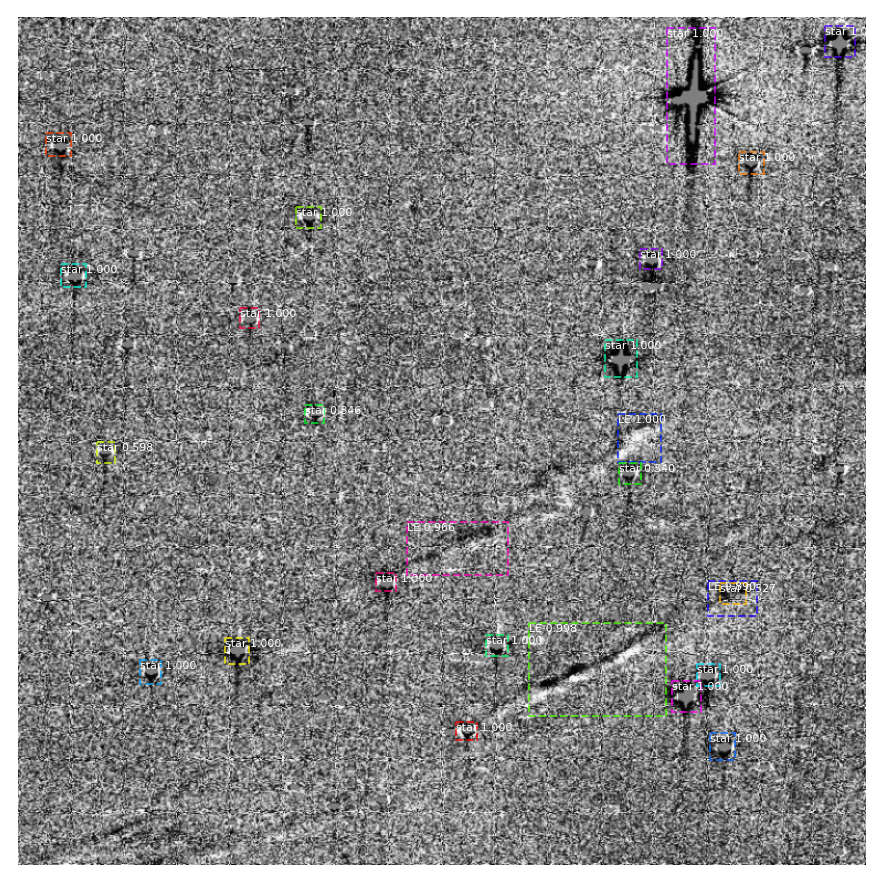

In [55]:
detect_on(train_dataset[2])

46.jpg


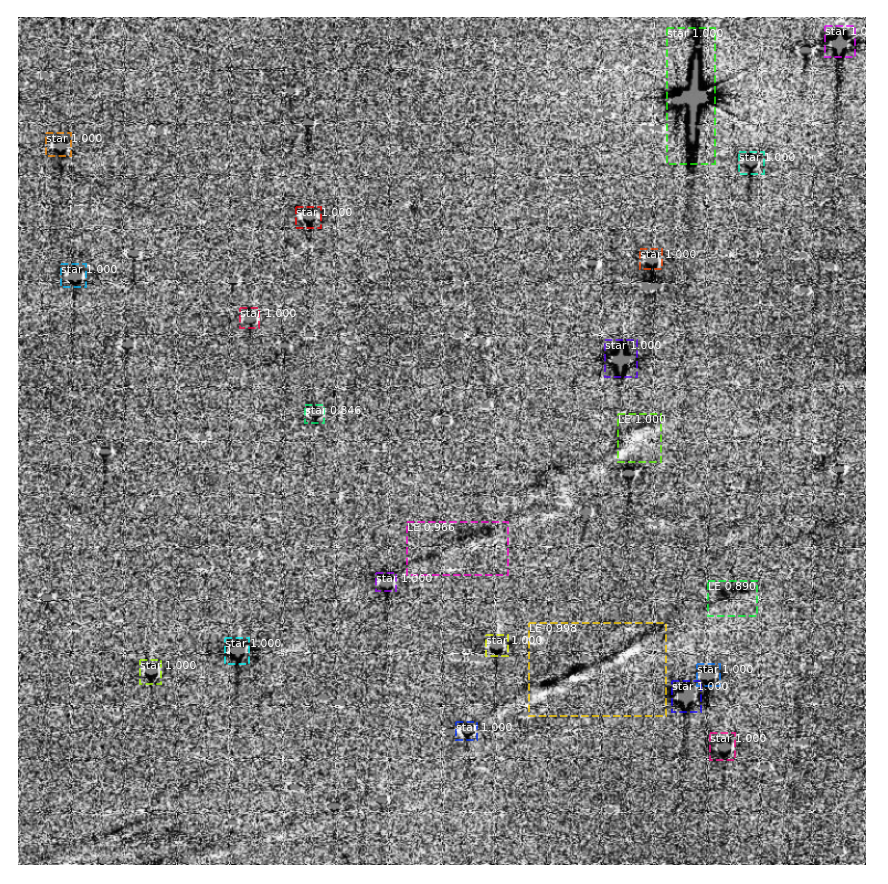

In [48]:
detect_on(train_dataset[2])

46.jpg


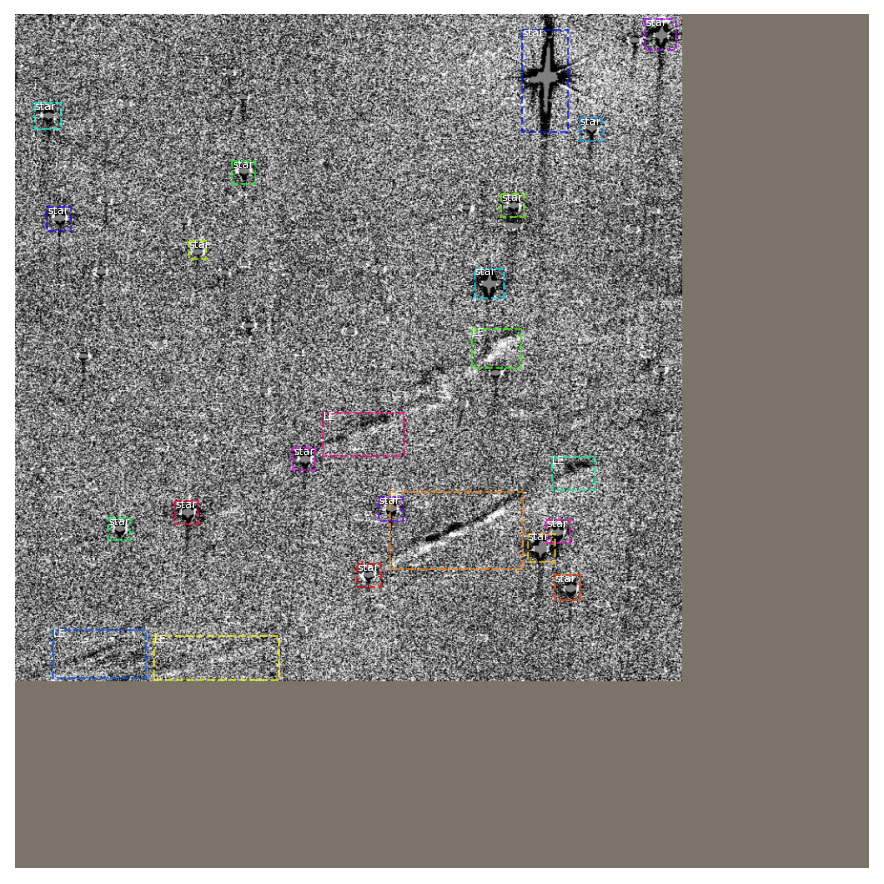

In [47]:
view_label(train_dataset[2])

127.jpg


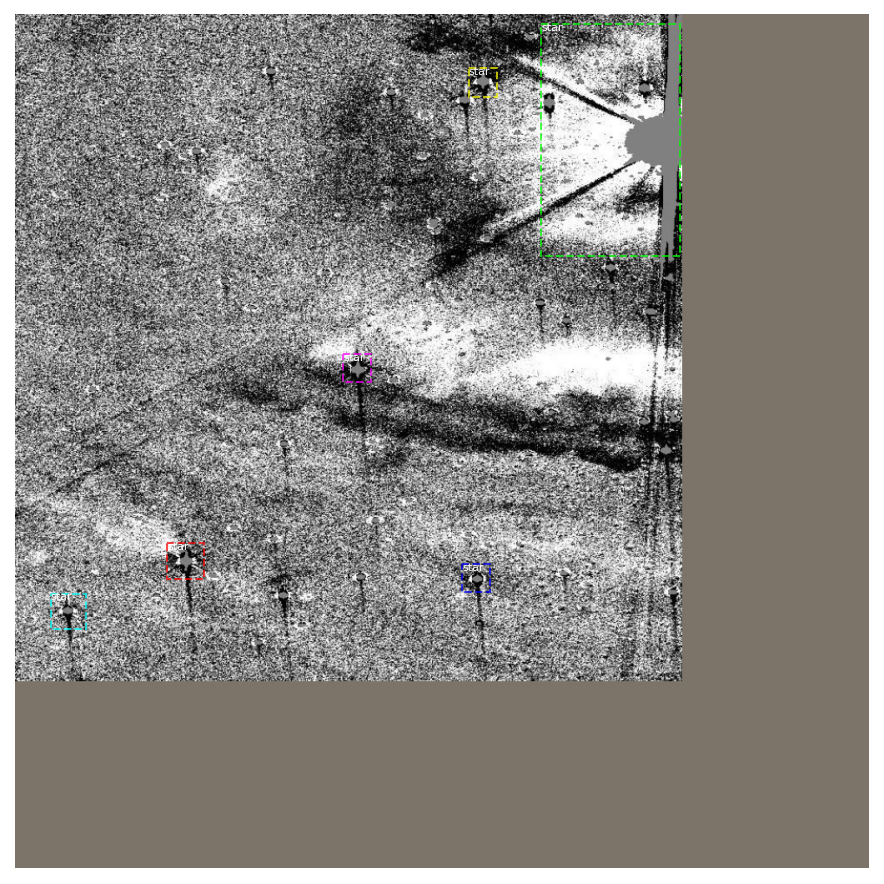

In [57]:
view_label(test_dataset[5])

47.jpg


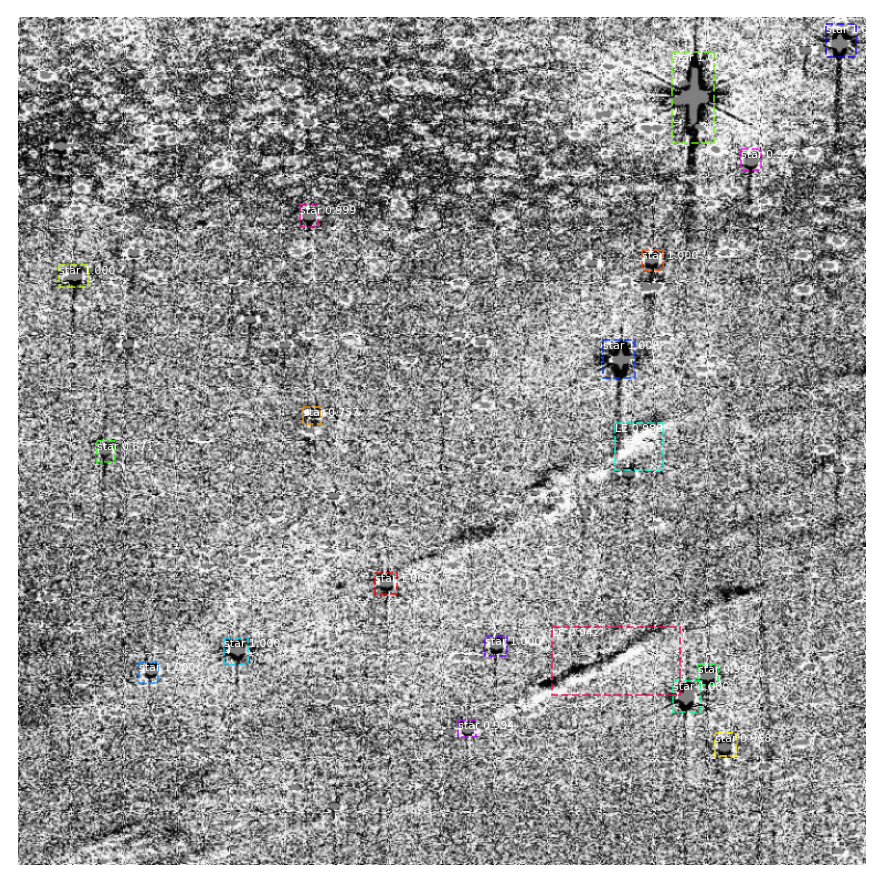

In [72]:
detect_on(test_dataset[2])

127.jpg


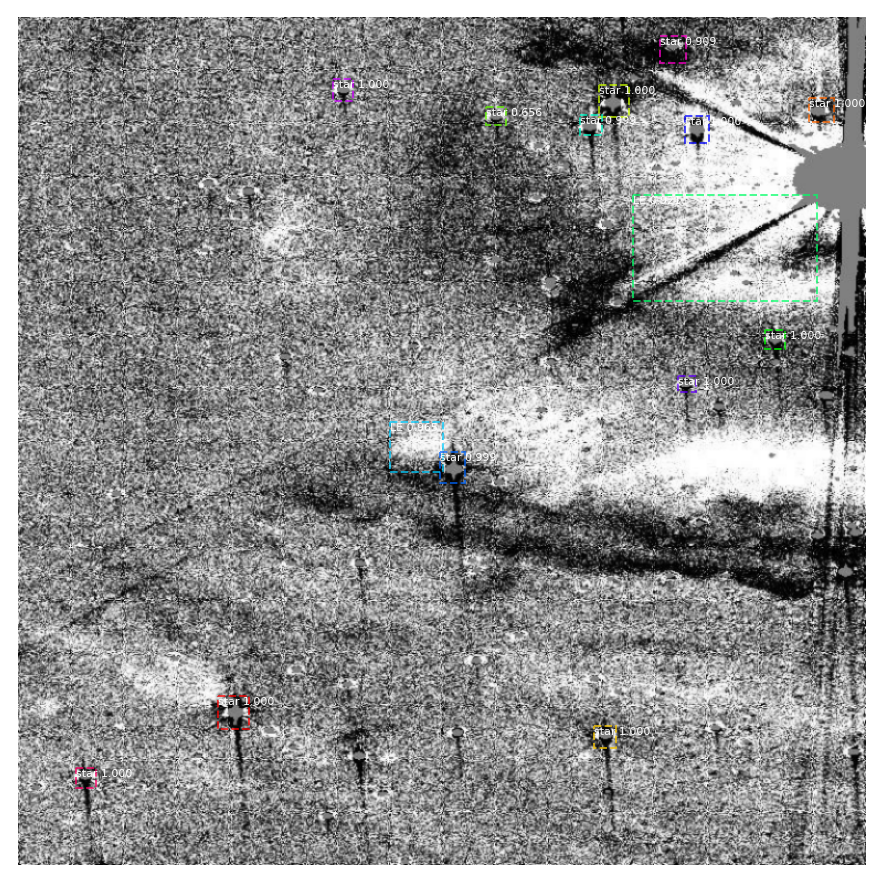

In [58]:
detect_on(test_dataset[5])

19.jpg


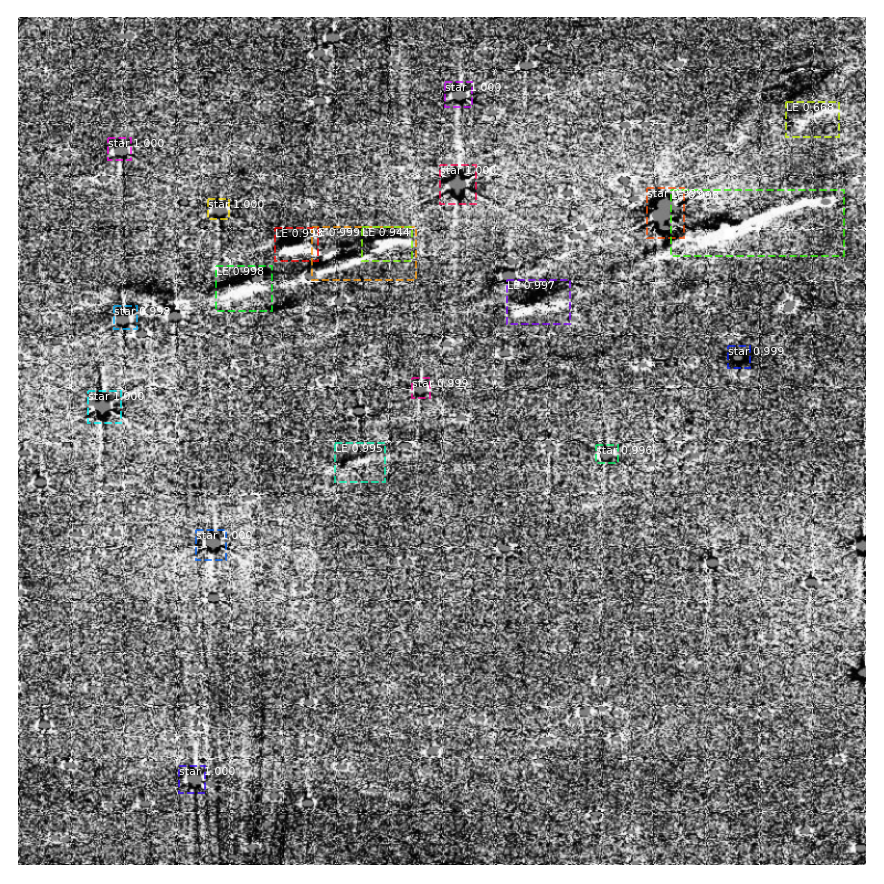

In [56]:
detect_on(test_dataset[10])

19.jpg


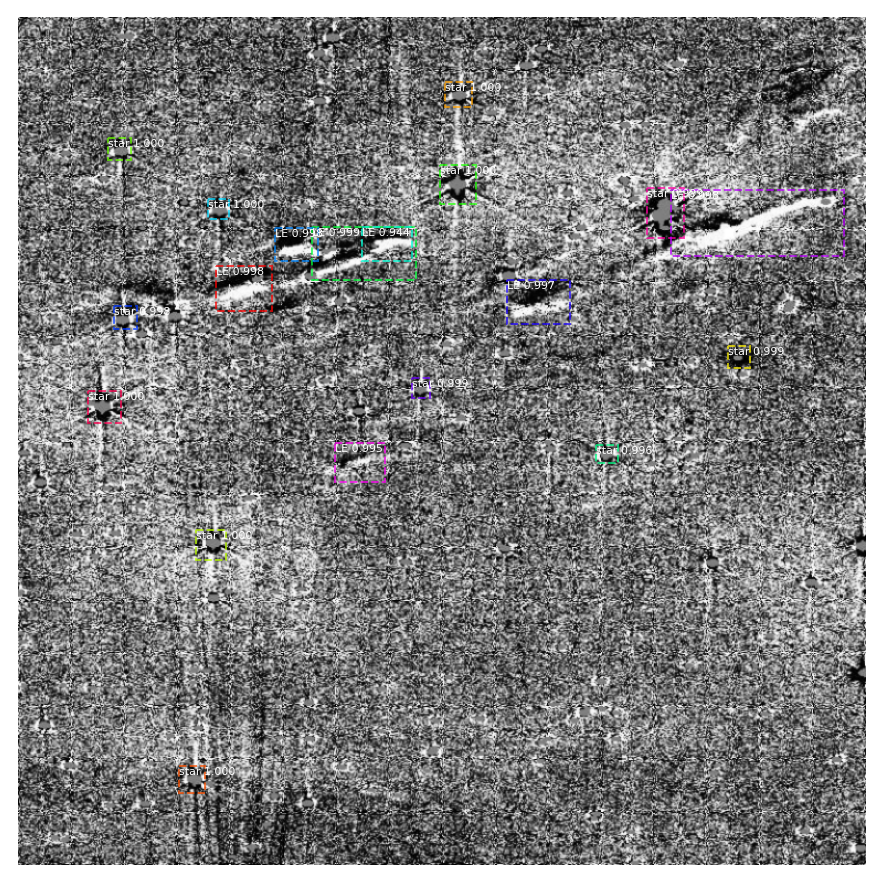

In [46]:
detect_on(test_dataset[10])

170.jpg


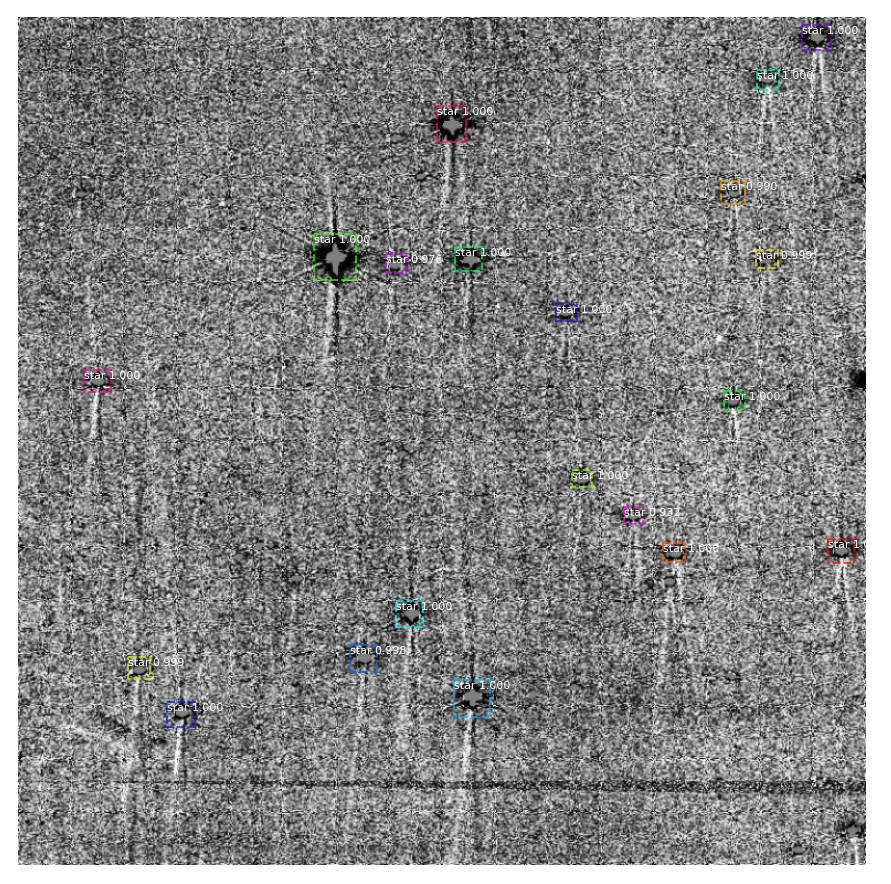

In [32]:
detect_on(train_dataset[4])

170.jpg


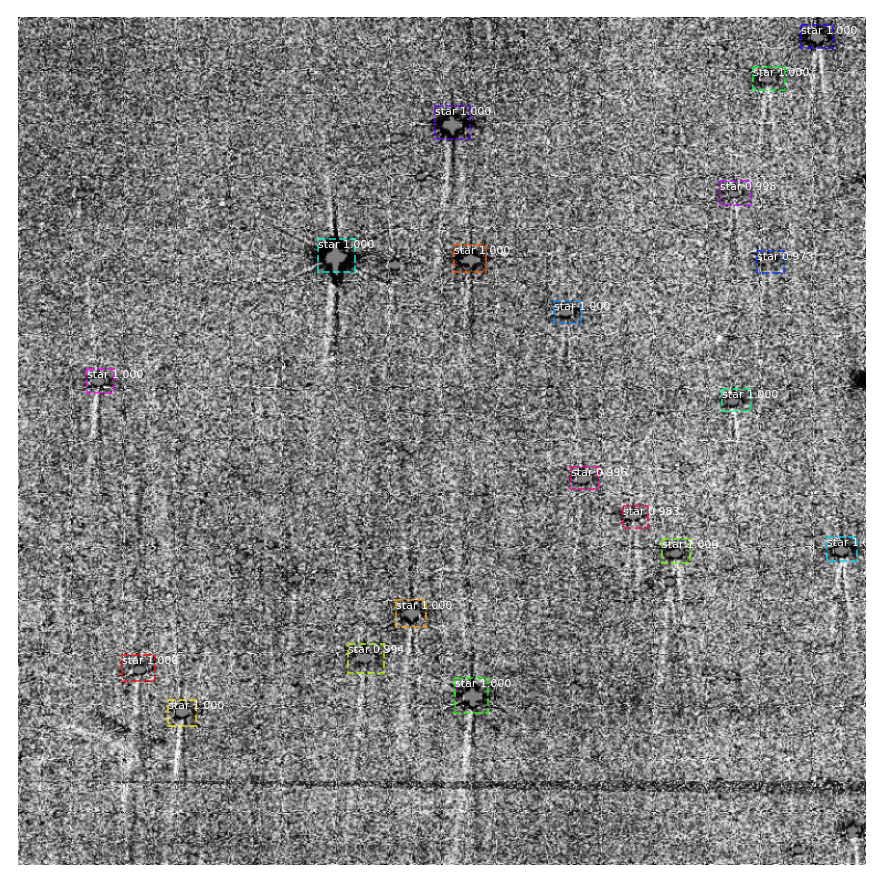

In [29]:
detect_on(train_dataset[4])

159.jpg


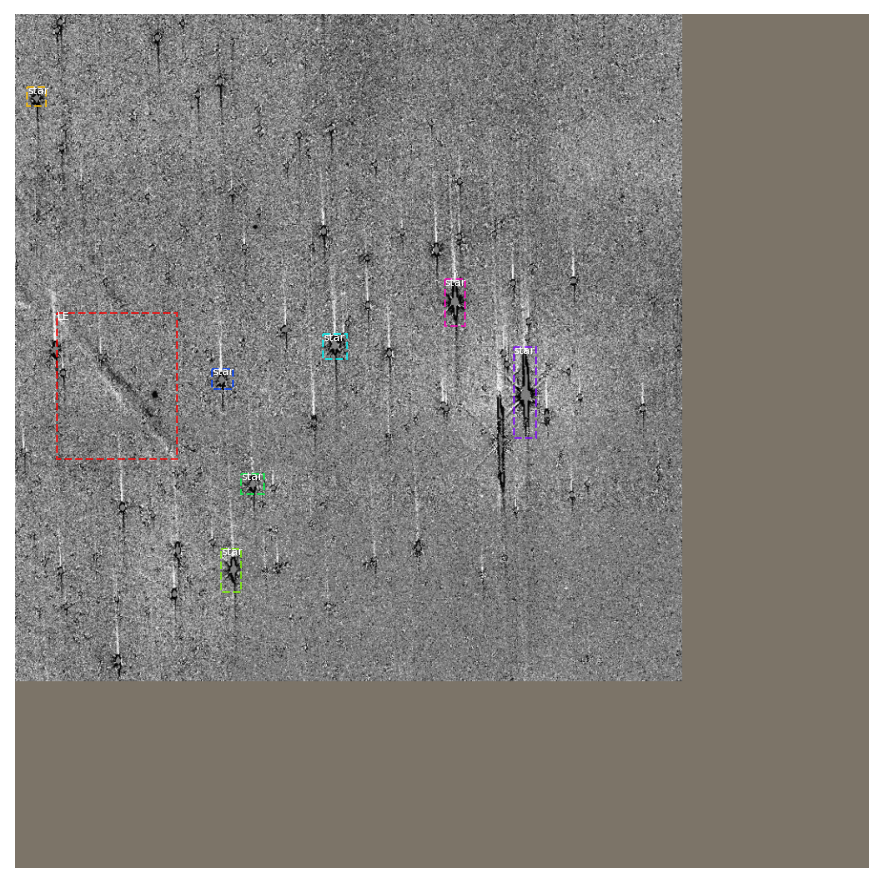

In [ ]:
view_label(test_dataset[0])

160.jpg


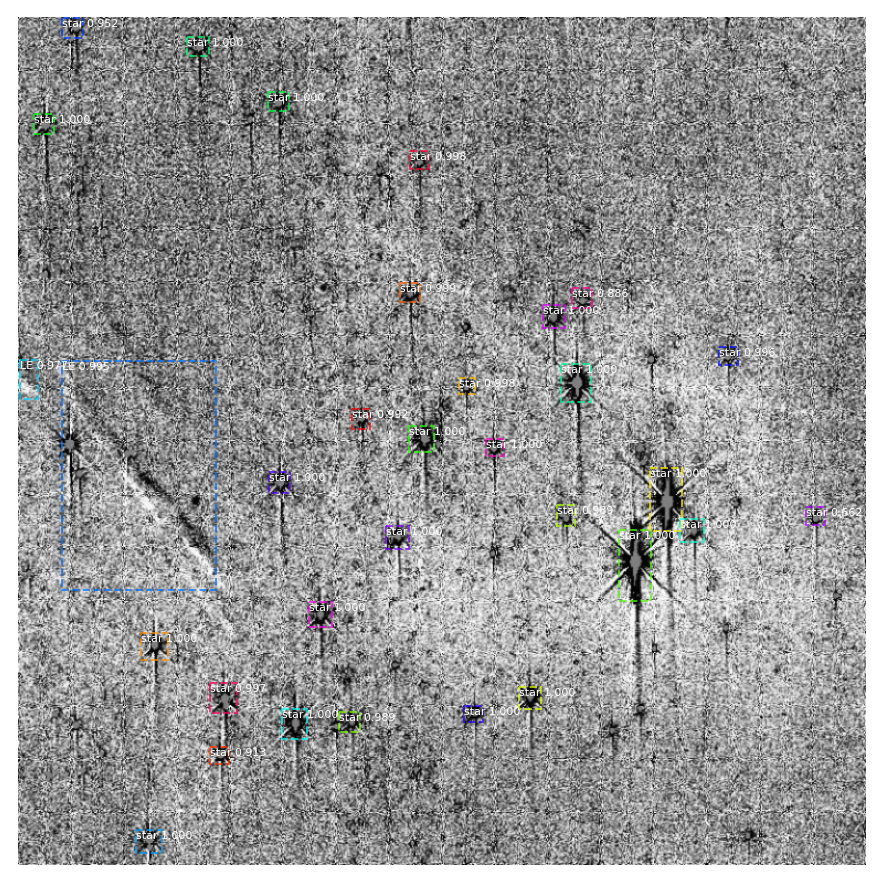

In [73]:
detect_on(train_dataset[9])

160.jpg


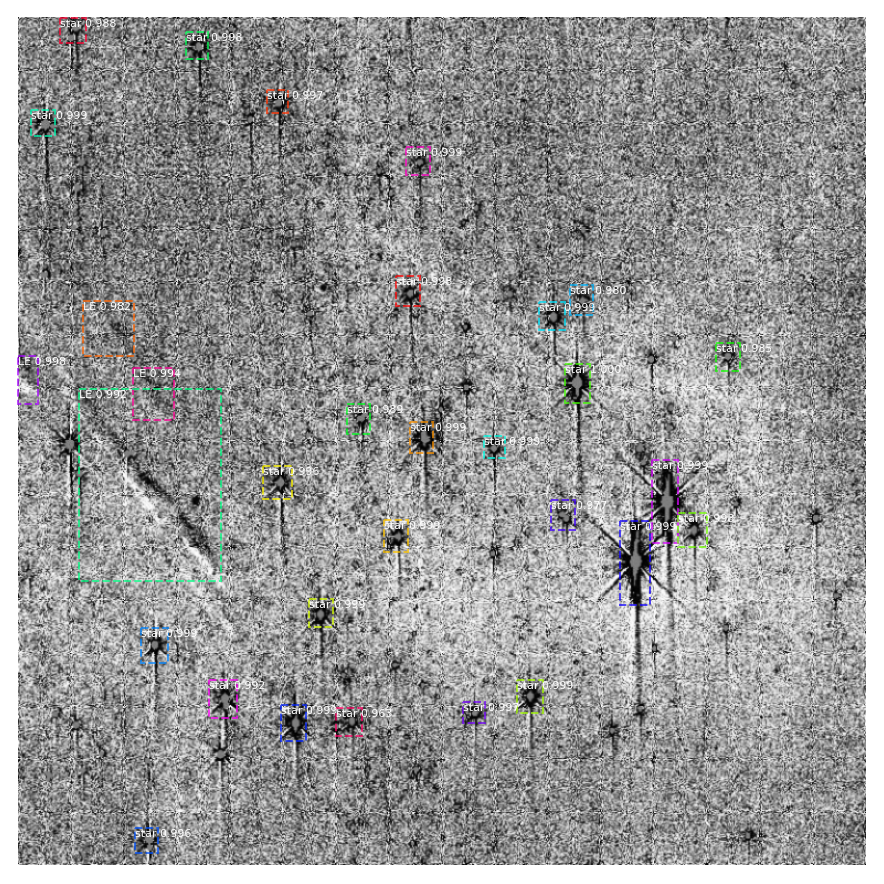

In [ ]:
detect_on(train_dataset[9])

### Train



In [ ]:
batch_imgs = tf.Variable(np.expand_dims(img, 0))
batch_metas = tf.Variable(np.expand_dims(img_meta, 0))
batch_bboxes = tf.Variable(np.expand_dims(bboxes, 0))
batch_labels = tf.Variable(np.expand_dims(labels, 0))


TensorShape([1, 1024, 1024, 3])

In [30]:
# use tf.data
batch_size = 1

train_generator = data_generator.DataGenerator(train_dataset)

train_tf_dataset = tf.data.Dataset.from_generator(
    train_generator, (tf.float32, tf.float32, tf.float32, tf.int32))
train_tf_dataset = train_tf_dataset.padded_batch(
    batch_size, padded_shapes=([None, None, None], [None], [None, None], [None]))
train_tf_dataset = train_tf_dataset.prefetch(100).shuffle(100)


In [ ]:
for (batch, inputs) in enumerate(train_tf_dataset):
    batch_imgs, batch_metas, batch_bboxes, batch_labels = inputs
    print(batch, batch_imgs.shape, batch_bboxes.shape, batch_labels.shape)

./LE_coco/val2017/20.jpg
./LE_coco/val2017/6.jpg
0 (1, 1024, 1024, 3) (1, 23, 4) (1, 23)
1 (1, 1024, 1024, 3) (1, 26, 4) (1, 26)


In [ ]:
model.load_weights('weights/faster_rcnn.h5', by_name=True, skip_mismatch=True,)
#model.load_weights('weights/fasterrcnn_LE.h5', by_name=True, skip_mismatch=True,)


In [31]:
# train on tf_dataset
#optimizer = tf.keras.optimizers.SGD(1e-4, momentum=0.9, nesterov=True)
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)
epochs = 5
history = {}
for epoch in range(epochs):

    loss_history = []
    for (batch, inputs) in enumerate(train_tf_dataset):
    
        batch_imgs, batch_metas, batch_bboxes, batch_labels = inputs
        with tf.GradientTape() as tape:
            rpn_class_loss, rpn_bbox_loss, rcnn_class_loss, rcnn_bbox_loss = \
                model((batch_imgs, batch_metas, batch_bboxes, batch_labels), training=True)

            loss_value = rpn_class_loss + rpn_bbox_loss + rcnn_class_loss + rcnn_bbox_loss

        grads = tape.gradient(loss_value, model.trainable_variables)
        optimizer.apply_gradients(zip(grads, model.trainable_variables))

        loss_history.append(loss_value.numpy())
        model.save_weights("weights/fasterrcnn_LE.h5", overwrite=True)
        if batch % 10 == 0:
            print('epoch:', epoch, ', batch:', batch, ', loss:', np.mean(loss_history))

        history[epoch] = loss_history

103.jpg
40.jpg
46.jpg
28.jpg
170.jpg
52.jpg
126.jpg
167.jpg
18.jpg
160.jpg
136.jpg
157.jpg
Instructions for updating:
Use tf.identity instead.
epoch: 0 , batch: 0 , loss: 0.31138742
epoch: 0 , batch: 10 , loss: 0.46203044
103.jpg
40.jpg
46.jpg
28.jpg
170.jpg
52.jpg
126.jpg
167.jpg
18.jpg
160.jpg
136.jpg
157.jpg
epoch: 1 , batch: 0 , loss: 0.44719255
103.jpg
40.jpg
46.jpg
28.jpg
170.jpg
52.jpg
126.jpg
167.jpg
18.jpg
160.jpg
136.jpg
157.jpg
epoch: 2 , batch: 0 , loss: 0.26623034
epoch: 2 , batch: 10 , loss: 0.27504706
103.jpg
40.jpg
46.jpg
28.jpg
170.jpg
52.jpg
126.jpg
167.jpg
18.jpg
160.jpg
136.jpg
157.jpg
epoch: 3 , batch: 0 , loss: 0.18870771
epoch: 3 , batch: 10 , loss: 0.20230417
103.jpg
40.jpg
46.jpg
28.jpg
170.jpg
52.jpg
126.jpg
167.jpg
18.jpg
160.jpg
136.jpg
157.jpg
epoch: 4 , batch: 0 , loss: 0.13168259
epoch: 4 , batch: 10 , loss: 0.1510632


In [ ]:
import pandas as pd

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]

In [ ]:
plt.plot()

Text(0, 0.5, 'loss')

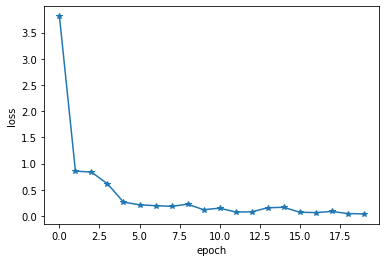

In [ ]:
x = list( history.keys() )
y = pd.DataFrame( history ).iloc[0]

plt.plot(x, y, '*-')
plt.xlabel('epoch')
plt.ylabel('loss')

In [ ]:
# train on single batch/image
optimizer = tf.keras.optimizers.SGD(1e-3, momentum=0.9, nesterov=True)

for epoch in range(100):
    with tf.GradientTape() as tape:
        rpn_class_loss, rpn_bbox_loss, rcnn_class_loss, rcnn_bbox_loss = \
            model((batch_imgs, batch_metas, batch_bboxes, batch_labels), training=True)

        loss_value = rpn_class_loss + rpn_bbox_loss + rcnn_class_loss + rcnn_bbox_loss

    grads = tape.gradient(loss_value, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

    print('epoch', epoch, '-', loss_value.numpy())


### Eval

In [74]:

val_dataset = train_dataset
print(len(val_dataset))

12


In [75]:
batch_size = 1

dataset_results = []
imgIds = []
for idx in range(len(val_dataset)):
    if idx % 10 == 0:
        print(idx)
    
    img, img_meta, _, _ = val_dataset[idx]

    proposals = model.simple_test_rpn(img, img_meta)
    res = model.simple_test_bboxes(img, img_meta, proposals)
    
    image_id = val_dataset.img_ids[idx]
    imgIds.append(image_id)
    
    for pos in range(res['class_ids'].shape[0]):
        results = dict()
        results['score'] = float(res['scores'][pos])
        results['category_id'] = val_dataset.label2cat[int(res['class_ids'][pos])]
        y1, x1, y2, x2 = [float(num) for num in list(res['rois'][pos])]
        results['bbox'] = [x1, y1, x2 - x1 + 1, y2 - y1 + 1]
        results['image_id'] = image_id
        dataset_results.append(results)


0
103.jpg
40.jpg
46.jpg
28.jpg
170.jpg
52.jpg
126.jpg
167.jpg
18.jpg
160.jpg
10
136.jpg
157.jpg


In [ ]:
val_dataset.get_categories()

['bg', '_background_', 'LE', 'star']

In [ ]:
import pandas as pd

In [ ]:
val_dataset.coco.dataset

In [ ]:
pd.DataFrame( dataset_results )

,score,category_id,bbox,image_id
0,0.999857,2,"[359.0423583984375, 146.483642578125, 17.26608...",0
1,0.999842,2,"[497.1238098144531, 306.0339050292969, 16.9106...",0
2,0.999818,2,"[256.0494384765625, 231.6806182861328, 17.0006...",0
3,0.999682,2,"[561.95458984375, 330.74884033203125, 15.10150...",0
4,0.999625,2,"[610.8628540039062, 346.57550048828125, 19.563...",0
5,0.999412,2,"[694.0936279296875, 591.7205200195312, 15.8182...",0
6,0.997303,2,"[542.2767333984375, 104.3840103149414, 18.3916...",0
7,0.988830,2,"[582.218017578125, 209.0009002685547, 14.89874...",0
8,0.984987,2,"[92.70124053955078, 92.15480041503906, 11.7534...",0
9,0.965781,2,"[199.74647521972656, 513.012451171875, 14.0409...",0


In [76]:
from pycocotools.cocoeval import COCOeval
import json

In [77]:
with open('coco_val2017_detection_result.json', 'w') as f:
    f.write(json.dumps(dataset_results))


In [78]:
coco_dt = val_dataset.coco.loadRes('coco_val2017_detection_result.json')


Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!


In [79]:
cocoEval = COCOeval(val_dataset.coco, coco_dt, 'bbox')


In [80]:
cocoEval.params.imgIds = imgIds
#cocoEval.params.catIds = [2, 3]
cocoEval.useCats = 1

In [81]:
cocoEval.evaluate()
cocoEval.accumulate()
cocoEval.summarize()


Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.14s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.239
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.697
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.071
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.211
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.306
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.088
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.270
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.327
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.320
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=10

In [ ]:
cocoEval.eval.keys()

dict_keys(['params', 'counts', 'date', 'precision', 'recall', 'scores'])

In [ ]:
cocoEval.eval['recall'].shape

(10, 3, 4, 3)

In [ ]:
cocoEval.eval['precision'].shape # T, R, K, A, M

(10, 101, 3, 4, 3)

In [ ]:
np.arange(0.5, 0.95, 0.05)

array([0.5 , 0.55, 0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 ])

In [ ]:
cocoEval.eval['precision'] [0, :, 0, 2]

In [83]:
import matplotlib.pyplot as plt

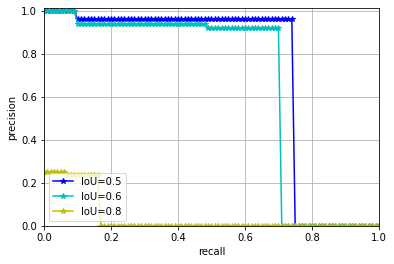

In [84]:
x = np.arange(0, 1.01, 0.01)

K = 1
A = 0
M = 1
y1 = cocoEval.eval['precision'] [0, :, K, A, M]
y2 = cocoEval.eval['precision'] [2, :, K, A, M]
y3 = cocoEval.eval['precision'] [6, :, K, A, M]

plt.plot(x, y1, 'b-*', label='IoU=0.5')
plt.plot(x, y2, 'c-*', label='IoU=0.6')
plt.plot(x, y3, 'y-*', label='IoU=0.8')
plt.xlabel('recall')
plt.ylabel('precision')
plt.xlim([0, 1])
plt.ylim([0, 1.01])
plt.legend(loc='lower left')
plt.grid(True)

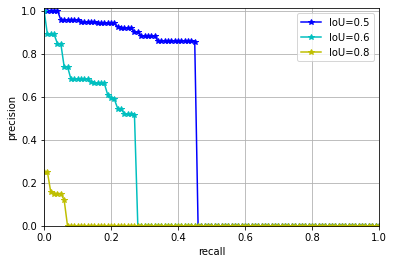

In [85]:
x = np.arange(0, 1.01, 0.01)

K = 2
A = 0
M = 1
y1 = cocoEval.eval['precision'] [0, :, K, A, M]
y2 = cocoEval.eval['precision'] [2, :, K, A, M]
y3 = cocoEval.eval['precision'] [6, :, K, A, M]

plt.plot(x, y1, 'b-*', label='IoU=0.5')
plt.plot(x, y2, 'c-*', label='IoU=0.6')
plt.plot(x, y3, 'y-*', label='IoU=0.8')
plt.xlabel('recall')
plt.ylabel('precision')
plt.xlim([0, 1])
plt.ylim([0, 1.01])
plt.legend()
plt.grid(True)